# Replicating the GTEx visualization

### Import modules, set paths, load files:

In [1]:
# !pip install scanpy
# !pip install ipywidgets
import scanpy as sc
import anndata
import numpy as np
import pandas as pd
import os

from tqdm import tqdm

In [2]:
# !pip install scarches
# !pip install -U pandas==2.0

import scarches as sca

 captum (see https://github.com/pytorch/captum).


In [3]:
# https://github.com/huggingface/transformers/issues/29763
# pip install transformers==4.37.2
import torch

In [4]:
import warnings

warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=UserWarning)

# GTEx replication - 1 

Reference: https://zenodo.org/records/5775379

harmony settings: https://github.com/lilab-bcb/harmony-pytorch

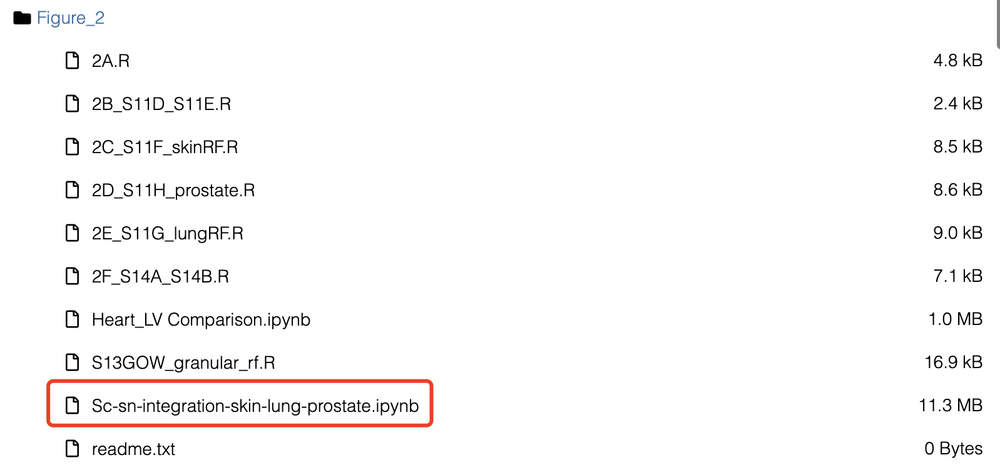

In [ ]:
path_input_data = '/home/fanhuan/data/BioInfo/453k/GTEx_8_tissues_snRNAseq_atlas_071421.public_obs.h5ad'
reference_adata = sc.read(path_input_data)

adata_concat = reference_adata

del adata_concat.obsm['X_umap']
# adata_concat

sc.pp.filter_cells(adata_concat, min_genes=100)
# adata_concat

# sc.pp.highly_variable_genes(adata_concat, n_top_genes=1000, batch_key='orig.ident')
sc.pp.highly_variable_genes(adata_concat, n_top_genes=1000, batch_key='Sample ID')
sc.pp.pca(adata_concat)

adata_concat._sanitize()

from harmony import harmonize
adata_concat.obsm['X_harmony'] = harmonize(adata_concat.obsm['X_pca'], adata_concat.obs, 'Sample ID')

sc.pp.neighbors(adata_concat, use_rep='X_harmony')
sc.tl.umap(adata_concat)

import seaborn as sns
import colorcet as cc

pal = sns.color_palette(cc.glasbey_hv)
pal = pal.as_hex()

adata_concat.uns['labels_colors'] = pal
adata_concat.uns['broad_labels_colors'] = pal
adata_concat.uns['Sample_ID_colors'] = pal

adata_concat._sanitize()

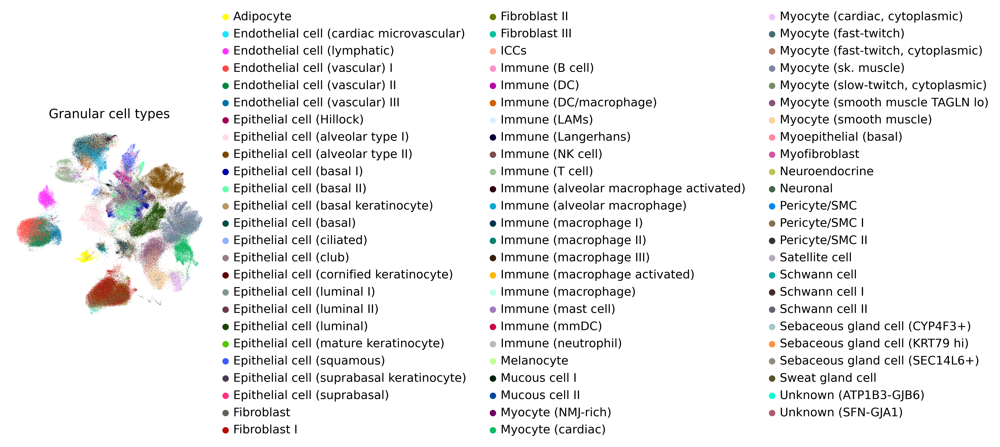

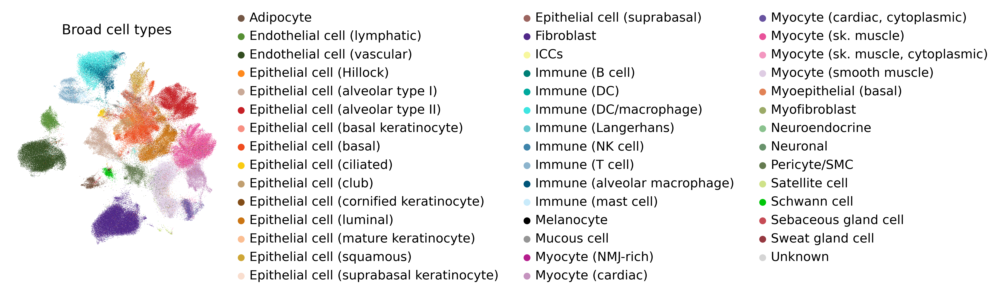

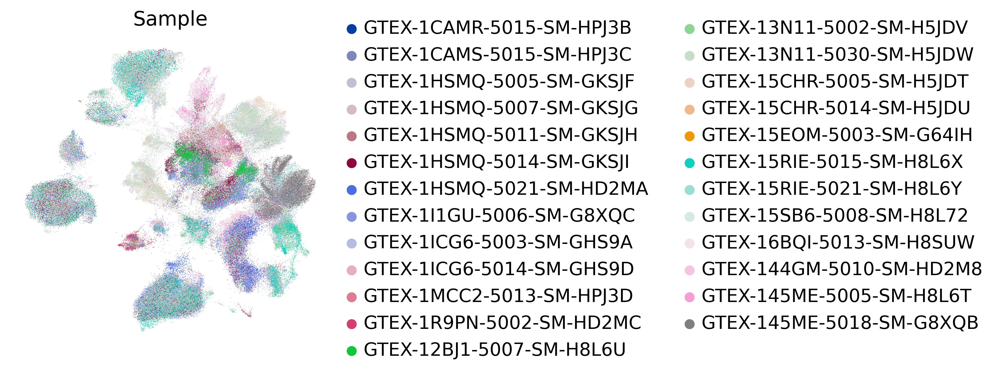

In [41]:
sc.pl.umap(adata_concat, color=['Granular cell type'], frameon=False, title=['Granular cell types'])
sc.pl.umap(adata_concat, color=['Broad cell type'], frameon=False, title=['Broad cell types'])
sc.pl.umap(adata_concat, color=['Sample ID'], frameon=False, title=['Sample'])

## Utilizing other batch_key

In [55]:
adata_concat

AnnData object with n_obs × n_vars = 209126 × 17695
    obs: 'n_genes', 'fpr', 'tissue', 'prep', 'individual', 'nGenes', 'nUMIs', 'PercentMito', 'PercentRibo', 'Age_bin', 'Sex', 'Sample ID', 'Participant ID', 'Sample ID short', 'RIN score from PAXgene tissue Aliquot', 'RIN score from Frozen tissue Aliquot', 'Autolysis Score', 'Sample Ischemic Time (mins)', 'Tissue Site Detail', 'scrublet', 'scrublet_score', 'barcode', 'batch', 'n_counts', 'tissue-individual-prep', 'Broad cell type', 'Granular cell type', 'introns', 'junctions', 'exons', 'sense', 'antisense', 'intergenic', 'batch-barcode', 'exon_ratio', 'intron_ratio', 'junction_ratio', 'log10_nUMIs', 'leiden', 'leiden_tissue', 'Tissue composition', 'Cell types level 2', 'Cell types level 3', 'Broad cell type numbers', 'Broad cell type (numbers)', 'Tissue', 'channel'
    var: 'gene_ids', 'Chromosome', 'Source', 'Start', 'End', 'Strand', 'gene_name', 'gene_source', 'gene_biotype', 'gene_length', 'gene_coding_length', 'Approved symbol', '

In [78]:
adata_concat.obs['prep']

CST01_TAGGCATGTAAATACG-skeletalmuscle    CST
CST01_CCTTACGTCCGTCAAA-skeletalmuscle    CST
CST01_CACACTCCATGGAATA-skeletalmuscle    CST
CST01_CCACTACGTGCAACGA-skeletalmuscle    CST
CST01_GCAGTTAAGACTGTAA-skeletalmuscle    CST
                                        ... 
NST03_ACACCCTTCAGCGATT-skin              NST
NST03_ACGCCAGCAACTGCGC-skin              NST
NST03_ATGTGTGGTGACCAAG-skin              NST
NST03_CACAGTATCTTCGGTC-skin              NST
NST03_GGCTGGTAGGCCCGTT-skin              NST
Name: prep, Length: 209068, dtype: category
Categories (4, object): ['CST', 'EZ', 'NST', 'TST']

In [79]:
path_input_data = '/home/fanhuan/data/BioInfo/453k/GTEx_8_tissues_snRNAseq_atlas_071421.public_obs.h5ad'
reference_adata = sc.read(path_input_data)

adata_concat = reference_adata

del adata_concat.obsm['X_umap']
# adata_concat

sc.pp.filter_cells(adata_concat, min_genes=100)
# adata_concat

# sc.pp.highly_variable_genes(adata_concat, n_top_genes=1000, batch_key='orig.ident')
sc.pp.highly_variable_genes(adata_concat, n_top_genes=1000, batch_key='prep')
sc.pp.pca(adata_concat)

adata_concat._sanitize()

from harmony import harmonize
adata_concat.obsm['X_harmony'] = harmonize(adata_concat.obsm['X_pca'], adata_concat.obs, 'prep')

sc.pp.neighbors(adata_concat, use_rep='X_harmony')
sc.tl.umap(adata_concat)

import seaborn as sns
import colorcet as cc

pal = sns.color_palette(cc.glasbey_hv)
pal = pal.as_hex()

adata_concat.uns['labels_colors'] = pal
adata_concat.uns['broad_labels_colors'] = pal
adata_concat.uns['tissue_colors'] = pal

adata_concat._sanitize()

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
	Completed 9 / 10 iteration(s).
	Completed 10 / 10 iteration(s).


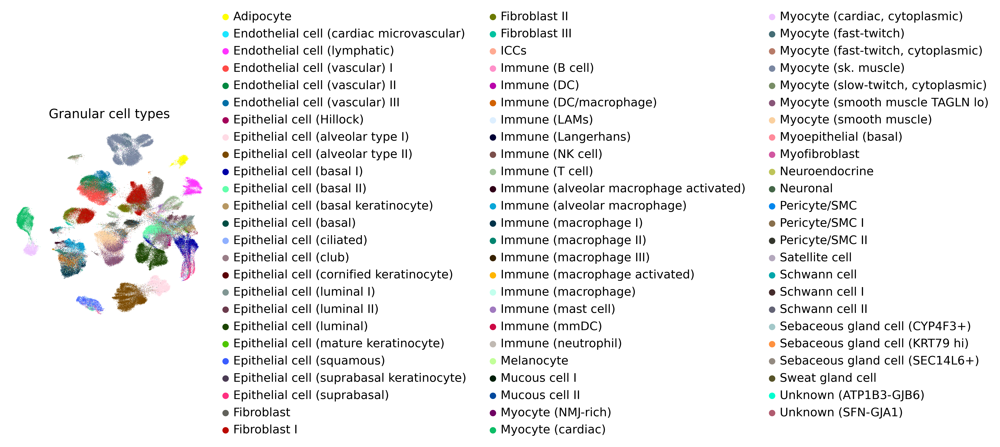

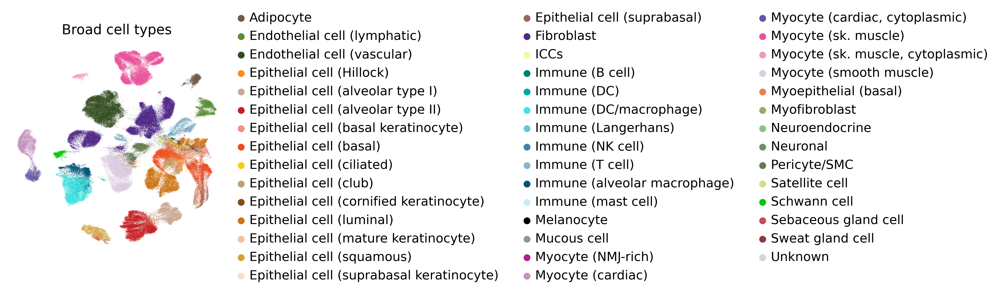

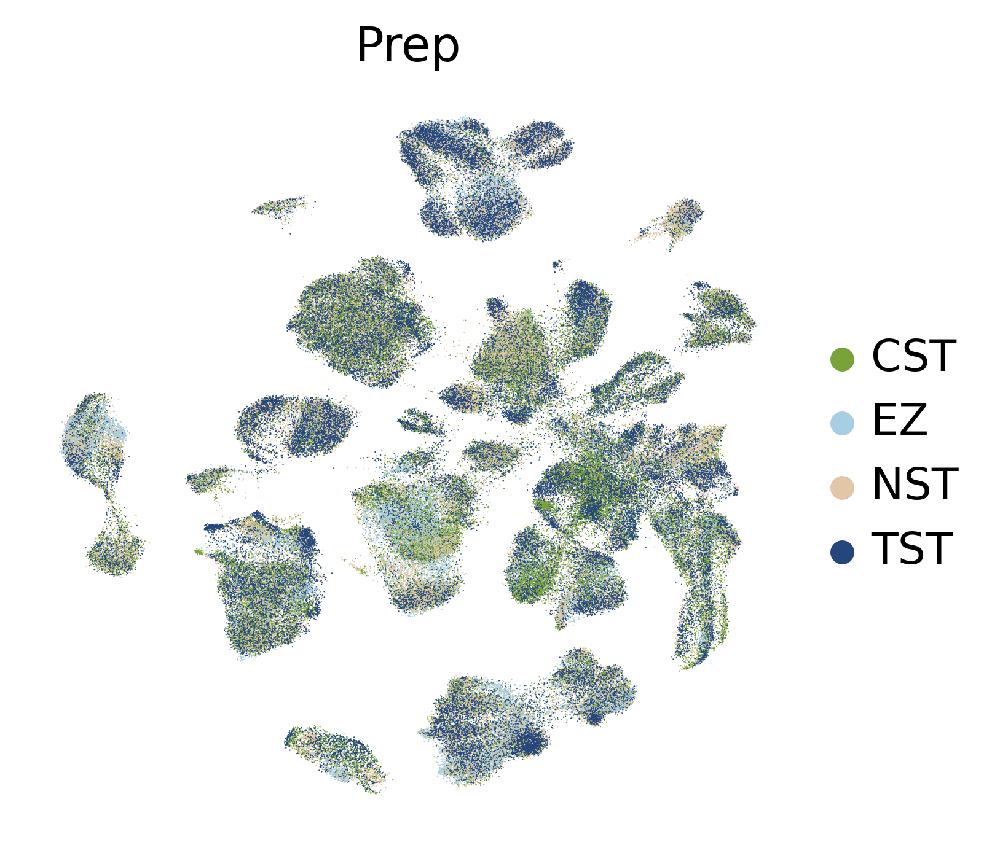

In [81]:
sc.pl.umap(adata_concat, color=['Granular cell type'], frameon=False, title=['Granular cell types'])
sc.pl.umap(adata_concat, color=['Broad cell type'], frameon=False, title=['Broad cell types'])
sc.pl.umap(adata_concat, color=['prep'], frameon=False, title=['Prep'])

In [58]:
path_input_data = '/home/fanhuan/data/BioInfo/453k/GTEx_8_tissues_snRNAseq_atlas_071421.public_obs.h5ad'
reference_adata = sc.read(path_input_data)

adata_concat = reference_adata

del adata_concat.obsm['X_umap']
# adata_concat

sc.pp.filter_cells(adata_concat, min_genes=100)
# adata_concat

# sc.pp.highly_variable_genes(adata_concat, n_top_genes=1000, batch_key='orig.ident')
sc.pp.highly_variable_genes(adata_concat, n_top_genes=1000, batch_key='tissue')
sc.pp.pca(adata_concat)

adata_concat._sanitize()

from harmony import harmonize
adata_concat.obsm['X_harmony'] = harmonize(adata_concat.obsm['X_pca'], adata_concat.obs, 'tissue')

sc.pp.neighbors(adata_concat, use_rep='X_harmony')
sc.tl.umap(adata_concat)

import seaborn as sns
import colorcet as cc

pal = sns.color_palette(cc.glasbey_hv)
pal = pal.as_hex()

adata_concat.uns['labels_colors'] = pal
adata_concat.uns['broad_labels_colors'] = pal
adata_concat.uns['tissue_colors'] = pal

adata_concat._sanitize()

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
Reach convergence after 2 iteration(s).


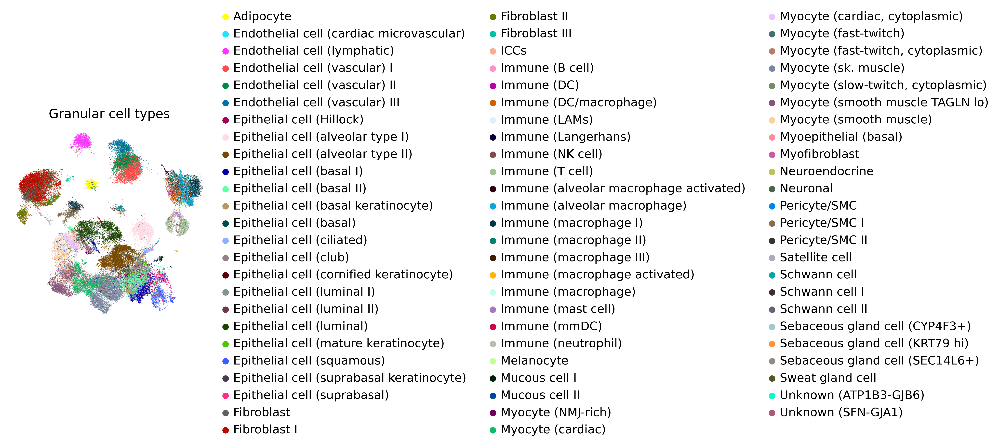

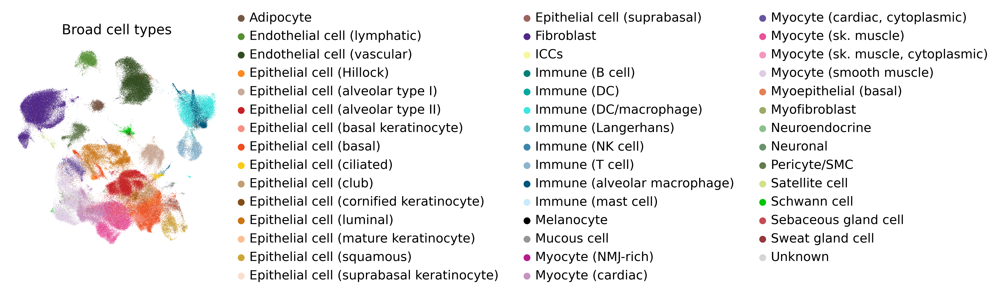

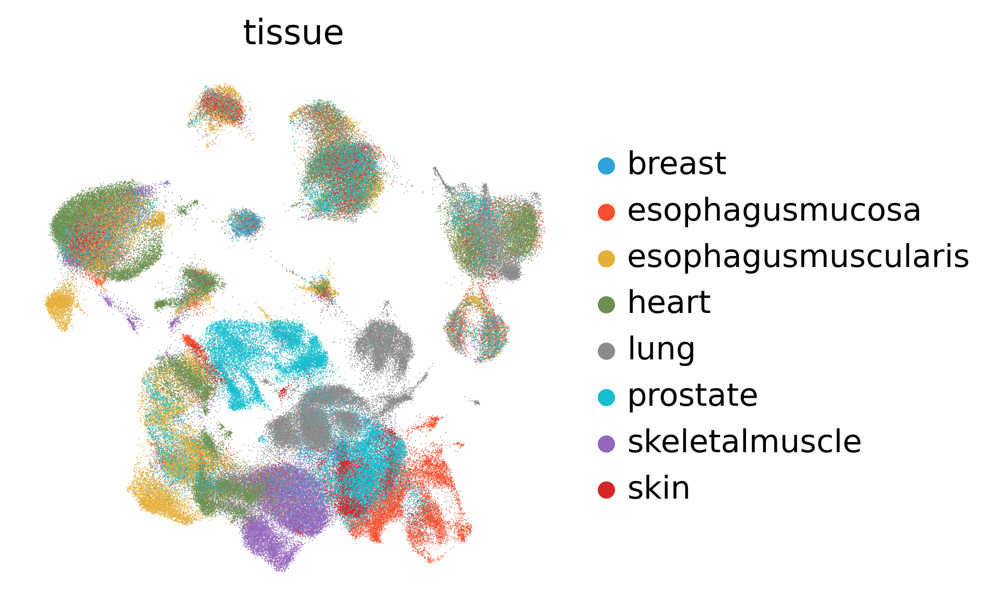

In [60]:
sc.pl.umap(adata_concat, color=['Granular cell type'], frameon=False, title=['Granular cell types'])
sc.pl.umap(adata_concat, color=['Broad cell type'], frameon=False, title=['Broad cell types'])
sc.pl.umap(adata_concat, color=['tissue'], frameon=False, title=['tissue'])